$\textbf{Taller 4 Metodos Computacionales 2}$

$\textbf{Punto 1) Ecuación de Poisson en un disco}$

In [51]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numba import njit

In [98]:
n = 500
x = np.linspace(-1.1 , 1.1, n)
y = np.linspace(-1.1, 1.1, n)
delta=abs(x[0]-x[1])

tolerancia = 1e-4
iter_max = 15000

phi = np.random.rand(n, n)

for i in range(n):
    for j in range(n):
        r=np.sqrt(x[i]**2+y[j]**2)
        if r>=1:
            theta=np.arctan2(y[j], x[i])
            phi[i,j]=np.sin(7*theta)
        

In [99]:
@njit
def iterar_poisson(phif, x, y, n, delta, tol, iter_max):
    for iteration in range(iter_max):
        phi_old = phif.copy()
        for i in range(1, n-1):
            for j in range(1, n-1):
                r = np.sqrt(x[i]**2 + y[j]**2)
                if r < 1:  
                    phif[i, j] = (phi_old[i+1, j] + phi_old[i-1, j] + phi_old[i, j+1] + phi_old[i, j-1] + 4 * np.pi * (-x[i] - y[j]) * delta**2) / 4
        
        error = np.abs(phif - phi_old).max() 
        if error < tol:
            break
    return phif

In [100]:
phi = iterar_poisson(phi, x, y, n, delta, tolerancia, iter_max)

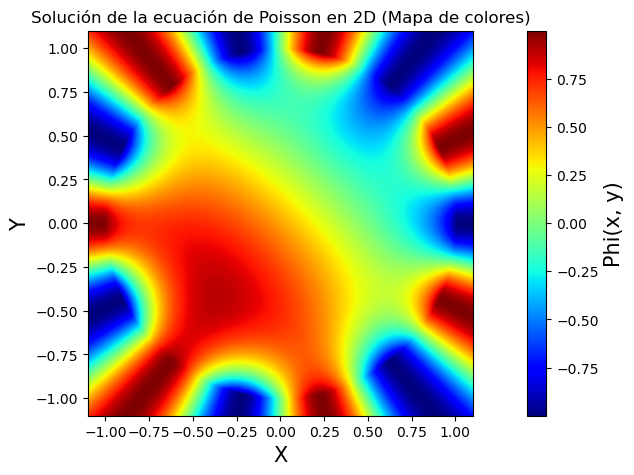

In [103]:
plt.figure()
plt.imshow(phi, extent=[x.min(), x.max(), y.min(), y.max()], origin='lower', cmap='jet')

# Añadir una barra de colores para indicar el valor de phi
plt.colorbar(label='Phi(x, y)')

# Etiquetas de los ejes
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Solución de la ecuación de Poisson en 2D (Mapa de colores)')

# Mostrar la gráfica
plt.show()

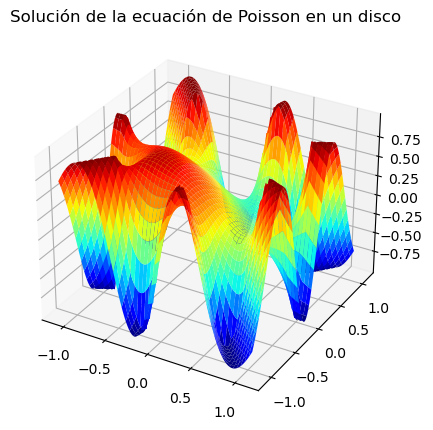

In [107]:
X, Y = np.meshgrid(x, y)  
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


ax.plot_surface(X, Y, phi, cmap='jet')


ax.set_title('Solución de la ecuación de Poisson en un disco')

plt.show()
    

$\textbf{Punto 2) Ecuación de onda unidimensional}$

In [116]:
import matplotlib.animation as animation
plt.rcParams["axes.labelsize"] = 15
plt.rcParams["figure.figsize"] = (14,5)
plt.rcParams["animation.html"] = "jshtml"

In [117]:
L = 2
T = 1      
c = 1
dx = 0.01    
dt = 0.005
nx=int(L/dx)
nt=int(T/dt)

C=c*dt/dx 

x = np.arange(0,L,dx)



In [118]:
def PDE_onda(arr,condicion):
    arr[0]=np.exp(-125*(x-1/2)**2)
    arr[0]=condicion(arr[0])
    for i in range (1,nx-1):
        arr[1,i]=arr[0, i]+0.5*C**2*(arr[0,i+1]-2*arr[0,i]+arr[0,i-1])
    arr[1]=condicion(arr[1])
    
    for n in range(1, nt-1): 
        for i in range(1, nx-1): 
            arr[n+1, i] = 2 * arr[n, i] - arr[n-1, i] + C**2 * (arr[n, i+1] - 2 * arr[n, i] + arr[n, i-1])
        arr[n+1]=condicion(arr[n+1])
    
    return arr

def Dirichlet(arr):
    arr[0] = 0
    arr[-1] = 0
    return arr

def Neumann(arr):
    arr[0] =  arr[1]
    arr[-1] = arr[-2]
    return arr

def Periodica(arr):
    arr[0] = arr[-2]
    arr[-1] = arr[1]
    return arr

U_Dirichlet = np.zeros( (nt,nx) ) * np.nan
U_Neumann = np.zeros( (nt,nx) ) * np.nan
U_Periodica = np.zeros( (nt,nx) ) * np.nan

U_Dirichlet=PDE_onda(U_Dirichlet,Dirichlet)
U_Neumann=PDE_onda(U_Neumann,Neumann)
U_Periodica=PDE_onda(U_Periodica,Periodica)



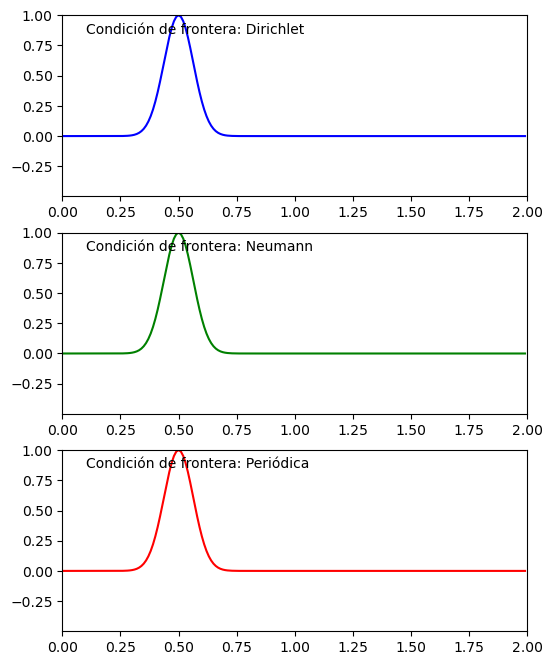

In [124]:
fig, axs = plt.subplots(3, 1, figsize=(6, 8))
for ax in axs:
    ax.set_xlim(0, L)
    ax.set_ylim(np.min(U_Dirichlet), np.max(U_Dirichlet))
    
line_dirichlet, = axs[0].plot(x, U_Dirichlet[0], 'b')
line_neumann, = axs[1].plot(x, U_Neumann[0], 'g')
line_periodic, = axs[2].plot(x, U_Periodica[0], 'r')

axs[0].text(0.05, 0.9, 'Condición de frontera: Dirichlet', transform=axs[0].transAxes)
axs[1].text(0.05, 0.9, 'Condición de frontera: Neumann', transform=axs[1].transAxes)
axs[2].text(0.05, 0.9, 'Condición de frontera: Periódica', transform=axs[2].transAxes)

def draw_frame(frame):
    line_dirichlet.set_ydata(U_Dirichlet[frame])
    line_neumann.set_ydata(U_Neumann[frame])
    line_periodic.set_ydata(U_Periodica[frame])
    return line_dirichlet, line_neumann, line_periodic

anim = animation.FuncAnimation(fig, draw_frame, frames=range(nt), interval=50, blit=False)




In [123]:
anim

$\textbf{Punto 3) Ondas no lineales, plasma y fluidos}$

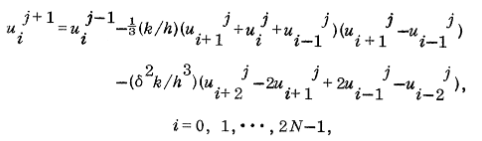

In [194]:
L3 = 2
T3 = 2.5
alpha = 0.022
dx3 = 0.01   
dt3 = 0.0001
nx3=int(L3/dx3)
nt3=int(T3/dt3)



x3 = np.arange(0,L3,dx3)

def condicion3(arr):
    arr[1]=arr[-3]
    arr[-2]=arr[2]
    arr[0] = arr[-2]
    arr[-1] = arr[1]
    
    return arr

U3=np.zeros( (nt3,nx3) )*np.nan

U3[0]=np.cos(np.pi*x3)
U3[0]=condicion3(U3[0])

for i in range(2,nx3-2):
    U3[1,i]=U3[0,i]-1/3*dt3/dx3*(U3[0,i+1]+U3[0,i]+U3[0,i-1])*(U3[0,i+1]-U3[0,i-1])-(alpha**2)*(dt3/(dx3)**2)*(U3[0,i+2]-2*U3[0,i+1]+2*U3[0,i-1]-U3[0,i-2])
U3[1]=condicion3(U3[1])

for n in range(1, nt3-1): 
    for i in range(2, nx3-2): 
        U3[n+1,i]=U3[n-1,i]-1/3*dt3/dx3*(U3[n,i+1]+U3[n,i]+U3[n,i-1])*(U3[n,i+1]-U3[n,i-1])-(alpha**2)*(dt3/(dx3)**2)*(U3[n,i+2]-2*U3[n,i+1]+2*U3[n,i-1]-U3[n,i-2])
    U3[n+1]=condicion3(U3[n+1])
    





C:\Users\david\AppData\Local\Temp\ipykernel_6316\1493136397.py:32: RuntimeWarning: overflow encountered in scalar multiply
  U3[n+1,i]=U3[n-1,i]-1/3*dt3/dx3*(U3[n,i+1]+U3[n,i]+U3[n,i-1])*(U3[n,i+1]-U3[n,i-1])-(alpha**2)*(dt3/(dx3)**2)*(U3[n,i+2]-2*U3[n,i+1]+2*U3[n,i-1]-U3[n,i-2])
C:\Users\david\AppData\Local\Temp\ipykernel_6316\1493136397.py:32: RuntimeWarning: invalid value encountered in scalar subtract
  U3[n+1,i]=U3[n-1,i]-1/3*dt3/dx3*(U3[n,i+1]+U3[n,i]+U3[n,i-1])*(U3[n,i+1]-U3[n,i-1])-(alpha**2)*(dt3/(dx3)**2)*(U3[n,i+2]-2*U3[n,i+1]+2*U3[n,i-1]-U3[n,i-2])
C:\Users\david\AppData\Local\Temp\ipykernel_6316\1493136397.py:32: RuntimeWarning: invalid value encountered in scalar add
  U3[n+1,i]=U3[n-1,i]-1/3*dt3/dx3*(U3[n,i+1]+U3[n,i]+U3[n,i-1])*(U3[n,i+1]-U3[n,i-1])-(alpha**2)*(dt3/(dx3)**2)*(U3[n,i+2]-2*U3[n,i+1]+2*U3[n,i-1]-U3[n,i-2])


KeyboardInterrupt: 

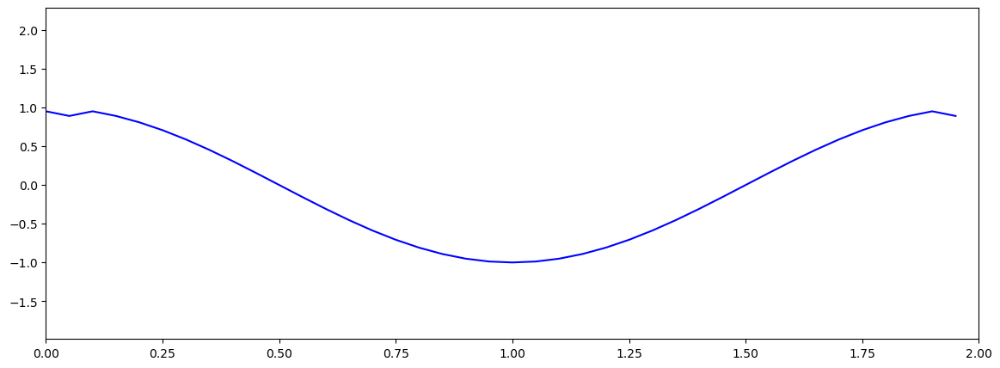

In [192]:
fig = plt.figure()
ax = plt.axes(xlim=(0, L3), ylim=(np.min(U3), np.max(U3)))
point, = ax.plot(x3, U3[0], 'b')  # Inicializar el gráfico con el primer frame

# Función para actualizar la gráfica en cada frame
def draw_frame(frame):
    point.set_ydata(U3[frame])  # Actualiza los valores de y con el frame actual
    return point

# Crear la animación para graficar cada 10 frames
anim3 = animation.FuncAnimation(fig, draw_frame, frames=range(0, nt3, 100), interval=50, blit=False)


In [193]:
anim3
